In [1]:
import sunpy
import sunpy.map
import matplotlib.colors as colors
from astropy import *
import astropy.units as u
import pathlib
import json, urllib, numpy as np, matplotlib.pylab as plt, matplotlib.ticker as mtick, requests
import sunpy.map
import drms
from astropy.io import fits
from astropy.coordinates import SkyCoord
import astropy.units as u
from sunpy.cm import color_tables as ct
import sunpy.coordinates
from datetime import datetime as dt_obj
import matplotlib.dates as mdates
import matplotlib.colors as mcol
import matplotlib.patches as ptc
from matplotlib.dates import *
import math

import drms
c = drms.Client()

import warnings
warnings.filterwarnings('ignore')

In [2]:
import os
import numpy as np
import matplotlib.pyplot as plt

from astropy.io import fits

In [22]:
aia_dir = '2014/2014_fits_AIA0304'
hmi_dir = '2014/2014_fits_HMI'

In [23]:
aia_files = sorted(os.listdir(aia_dir))
hmi_files = sorted(os.listdir(hmi_dir))

In [24]:
print(len(aia_files))
print(len(hmi_files))

728
728


In [25]:
aia_files[0]

'aia_lev1_304a_2014_01_01t00_00_07_12z_image_lev1.fits'

In [26]:
hmi_files[0]

'hmi_m_45s_2014_01_01_00_01_30_tai_magnetogram.fits'

# AIA

In [8]:
# aia_5 = aia_files[:5]
# hmi_5 = hmi_files[:5]
'''
AIA

'''

'\nAIA\n\n'

In [10]:
# num = 2400
# for file in aia_files[:]:
#     try:
#         aia_map = sunpy.map.Map(os.path.join(aia_dir, file)).resample((1024, 1024)*u.pix)
#         figure = plt.figure(frameon=False)
#         axes = plt.Axes(figure, [0., 0., 1., 1.])
#         axes.set_axis_off()
#         figure.add_axes(axes)
#         im = aia_map.plot(axes=axes, annotate=False)
#         im.write_png(f'2015/2015_new1024images/newAIA0304/{num}.png')
#         num = num + 1
#     except:
#         num + num + 1

In [8]:
len(os.listdir('2015/2015_new1024images/newAIA0304'))

725

In [11]:
# import os
# import tarfile
# def tardir(path, tar_name):
#     with tarfile.open(tar_name, "w:gz") as tar_handle:
#         for root, dirs, files in os.walk(path):
#             for file in files:
#                 tar_handle.add(os.path.join(root, file))
# tardir('IMAGES/AIA304', 'AIA0_100.tar.gz')

# HMI

In [17]:
import matplotlib.pyplot as plt
from reproject import reproject_interp

import astropy.units as u

import sunpy.map
from sunpy.net import Fido
from sunpy.net import attrs as a
from PIL import Image
import cv2

In [18]:
# from natsort import natsorted
# aia_files = natsorted(os.listdir(aia_dir))
# hmi_files = natsorted(os.listdir(hmi_dir))

In [19]:
# for i, file in enumerate(aia_files[:5]):
#     print(i, file)

In [20]:
len(aia_files)

728

In [28]:
# for (aia, hmi) in  zip(aia_files[:5], hmi_files[:5]):
#     print(aia, hmi)

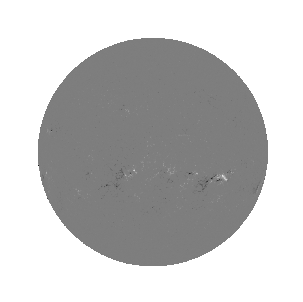

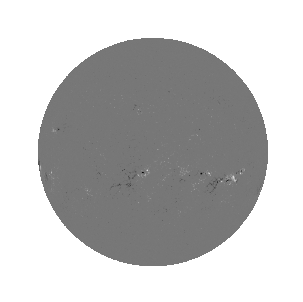

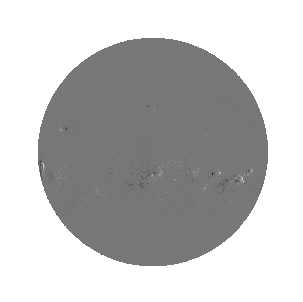

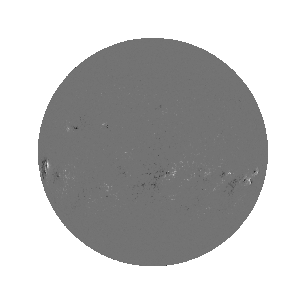

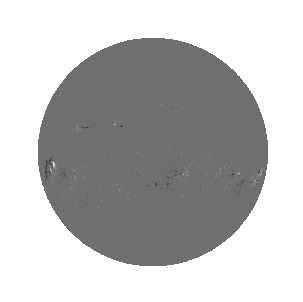

...

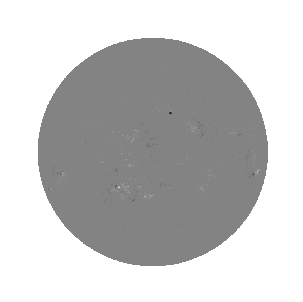

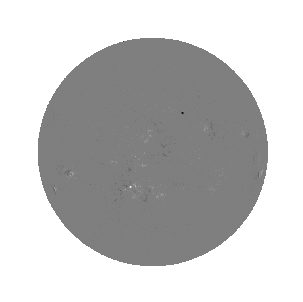

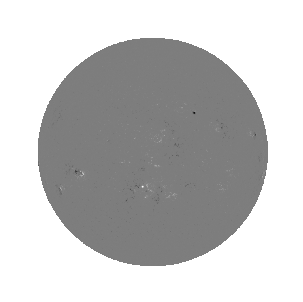

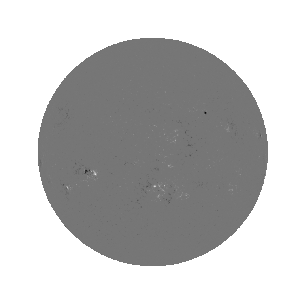

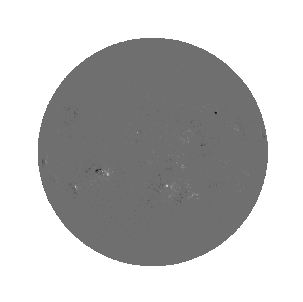

In [29]:
# create all HMI (align, centering, apply mask and create png)
num = 1600
for (aia, hmi) in  zip(aia_files[:], hmi_files[:]):
    try:
        hmi_map = sunpy.map.Map(os.path.join(hmi_dir, hmi)).resample((1024, 1024)*u.pix)
        aia_map = sunpy.map.Map(os.path.join(aia_dir, aia)).resample((1024, 1024)*u.pix)

        output, footprint = reproject_interp(hmi_map, aia_map.wcs, aia_map.data.shape)

        out_hmi = sunpy.map.Map(output, aia_map.wcs)

        figure = plt.figure(frameon=False)
        axes = plt.Axes(figure, [0., 0., 1., 1.])

        axes.set_axis_off()
        figure.add_axes(axes)

        img = out_hmi.plot(axes=axes, annotate=False)

        img.write_png(f'2014/2014_new1024images/newHMI/{num}.png')

        im = cv2.imread(f'2014/2014_new1024images/newHMI/{num}.png')
        height,width,depth = im.shape
        circle_img = np.zeros((height,width), np.uint8)
        cv2.circle(circle_img,(int(width/2),int(height/2)),1024,1,thickness=-1)
        masked_data = cv2.bitwise_and(im, im, mask=circle_img)

        im = Image.fromarray(masked_data)
        im.save(f'2014/2014_new1024images/newHMI/{num}.png')
        num += 1
    except:
        num += 1

In [ ]:
# # apply mask
# im = cv2.imread('hmi_01.png')
# height,width,depth = im.shape
# circle_img = np.zeros((height,width), np.uint8)
# cv2.circle(circle_img,(int(width/2),int(height/2)),4096,1,thickness=-1)
# masked_data = cv2.bitwise_and(im, im, mask=circle_img)

# from PIL import Image
# im = Image.fromarray(masked_data)
# im.save("masked.png")

In [15]:
# hmi_path = '2013/2013_new1024images/HMI/'
# aia_path = '2013/2013_new1024images/AIA0304/'
# from natsort import natsorted
# aia_files = natsorted(os.listdir(aia_path))
# hmi_files = natsorted(os.listdir(hmi_path))

In [16]:
# print(len(aia_files))
# print(len(hmi_files))

722
715


In [14]:
import shutil

In [24]:
# aia_dest = '2013/2013_new1024images/folderB/train/'
# hmi_dest = '2013/2013_new1024images/folderA/train/'

# from natsort import natsorted
# aia_files = natsorted(os.listdir(aia_path))
# hmi_files = natsorted(os.listdir(hmi_path))

# for (aia, hmi) in  zip(aia_files[:], hmi_files[:]):
#     print(aia, hmi)
#     if aia == hmi:
#         shutil.copy(aia_path+aia, aia_dest)
#         shutil.copy(hmi_path+hmi, hmi_dest)
#     else:
#         continue  

In [25]:
# aia_dest = '2013/2013_new1024images/folderB/train/'
# hmi_dest = '2013/2013_new1024images/folderA/train/'

# from natsort import natsorted
# aia_files = natsorted(os.listdir(aia_dest))
# hmi_files = natsorted(os.listdir(hmi_dest))

# print(len(aia_files))
# print(len(hmi_files))

438
438
